In [3]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../')

from main import load_and_prepare_sessions
from processing.session_sampling import MiceAnalysis
from config import attr_interval_dict, all_metrics, all_brain_regions, all_event_types
from analysis.timepoint_analysis import sample_signals_and_metrics
from plotting.main_plotting import plot_signals


sessions = load_and_prepare_sessions("../../Baseline", load_from_pickle=True, remove_bad_signal_sessions=True)
mouse_analyser = MiceAnalysis(sessions)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


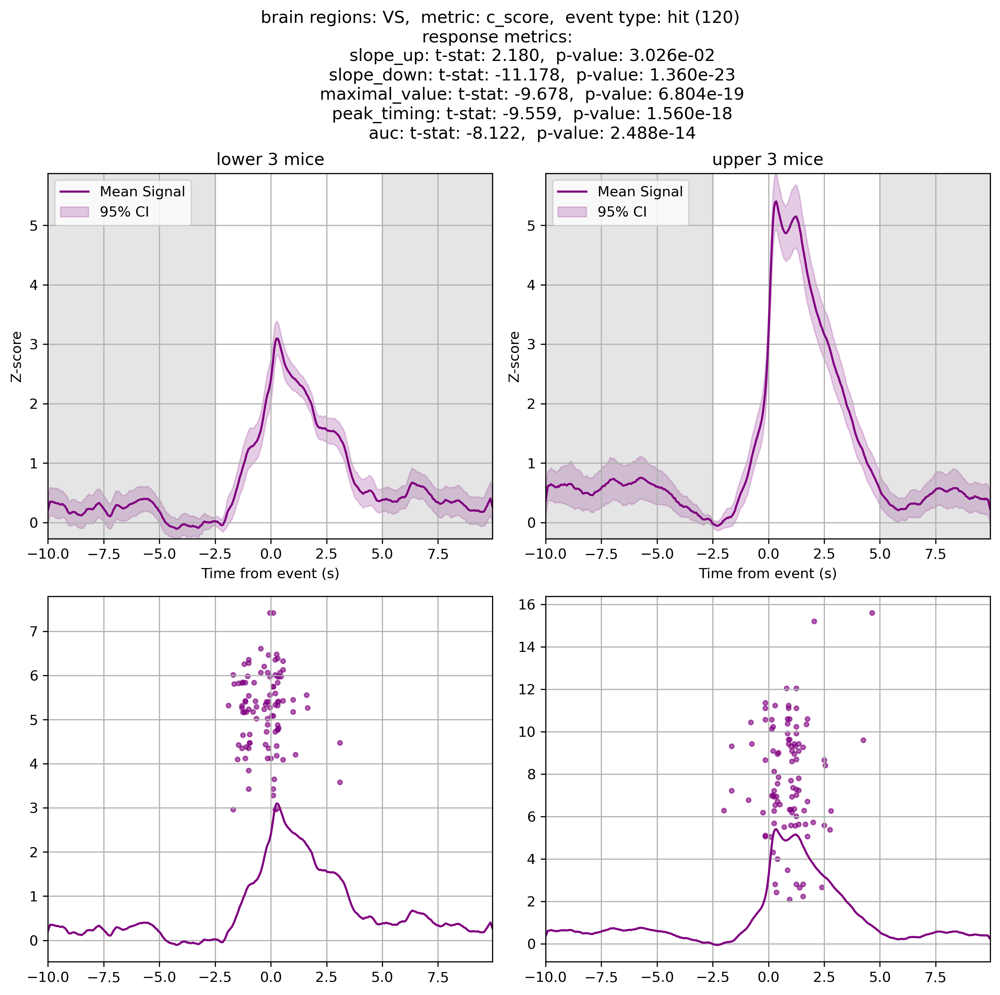

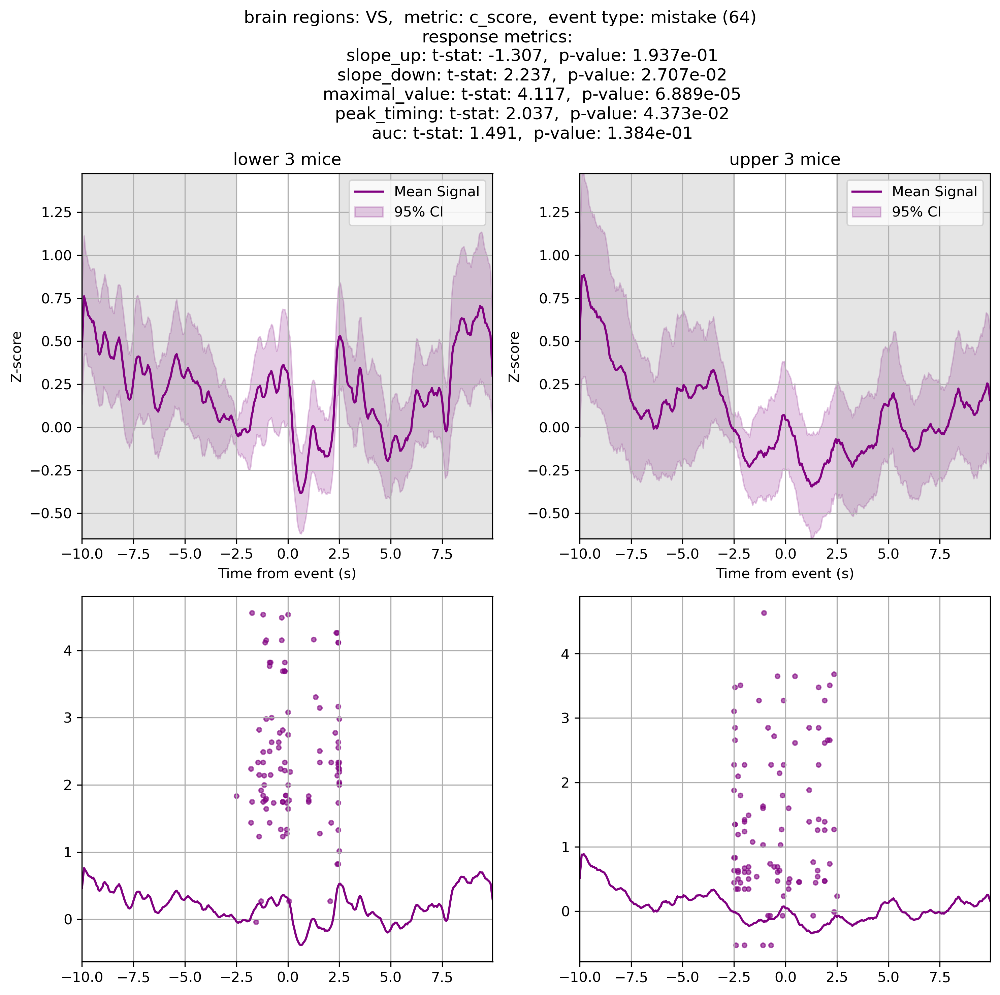

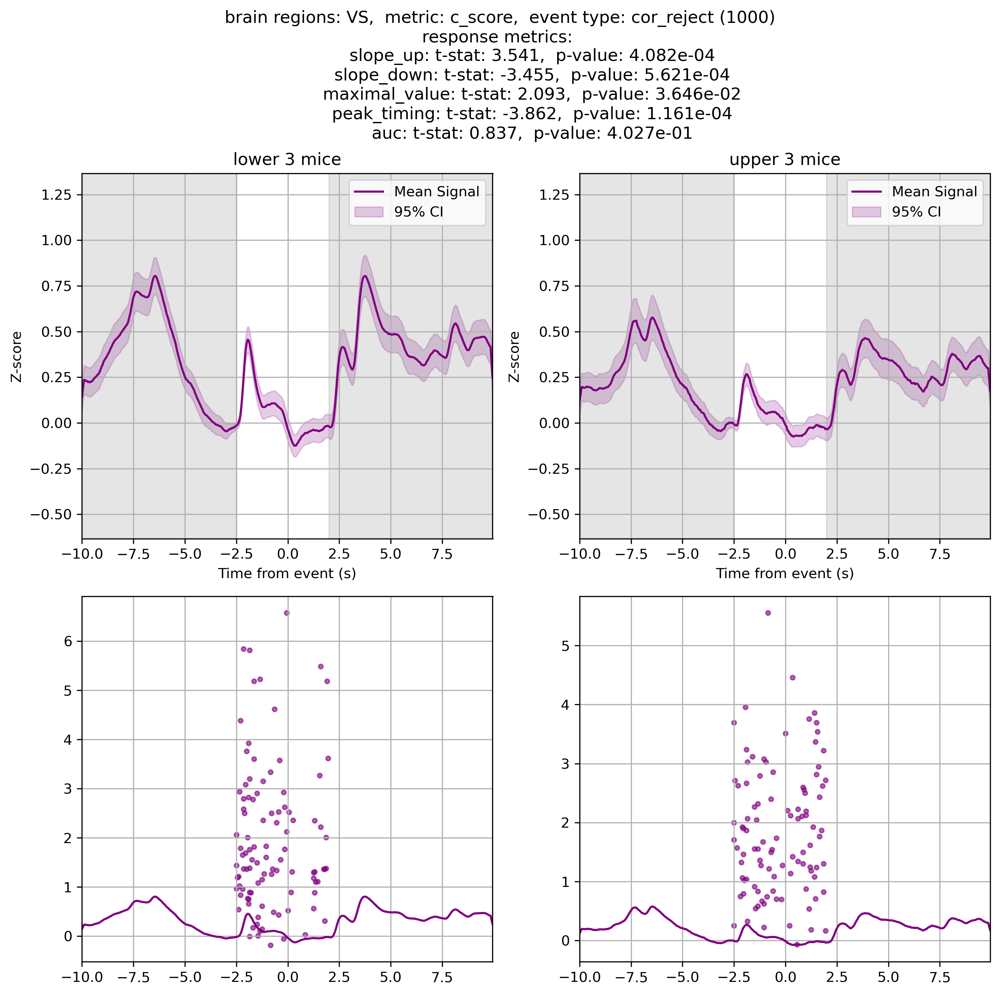

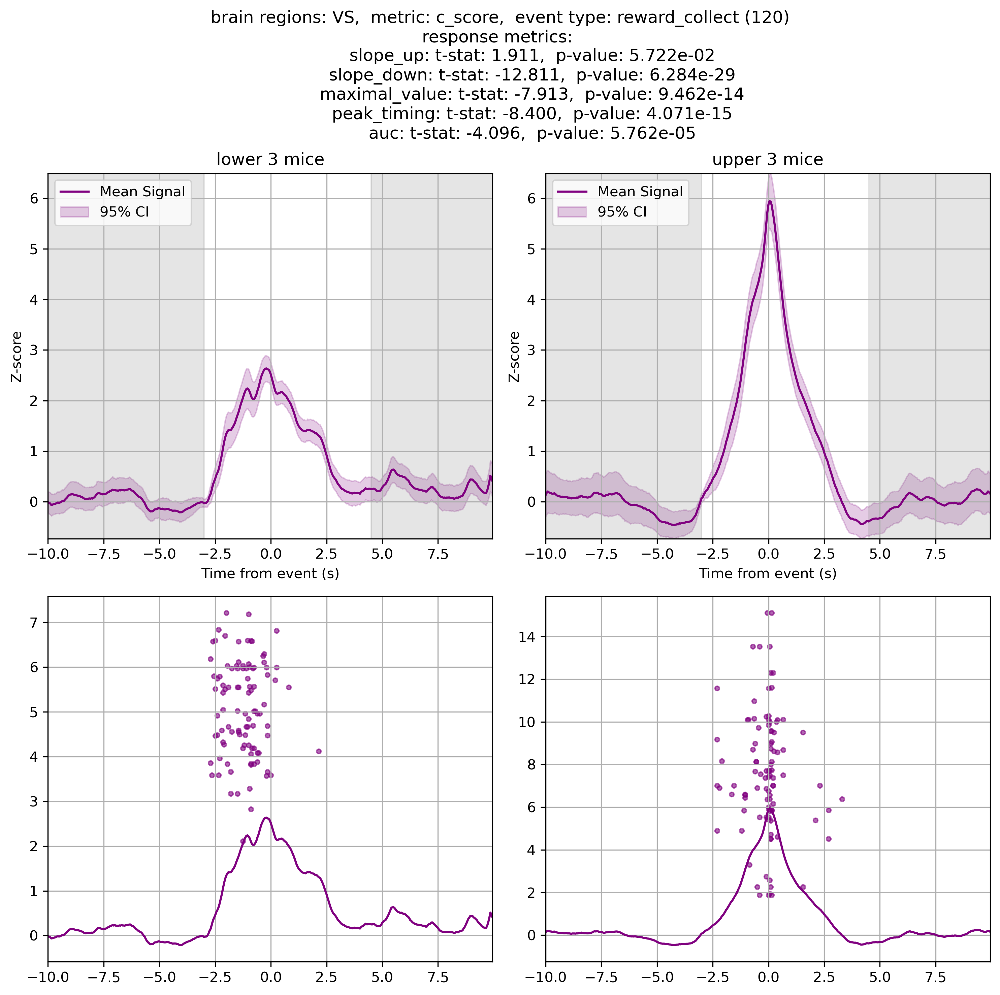

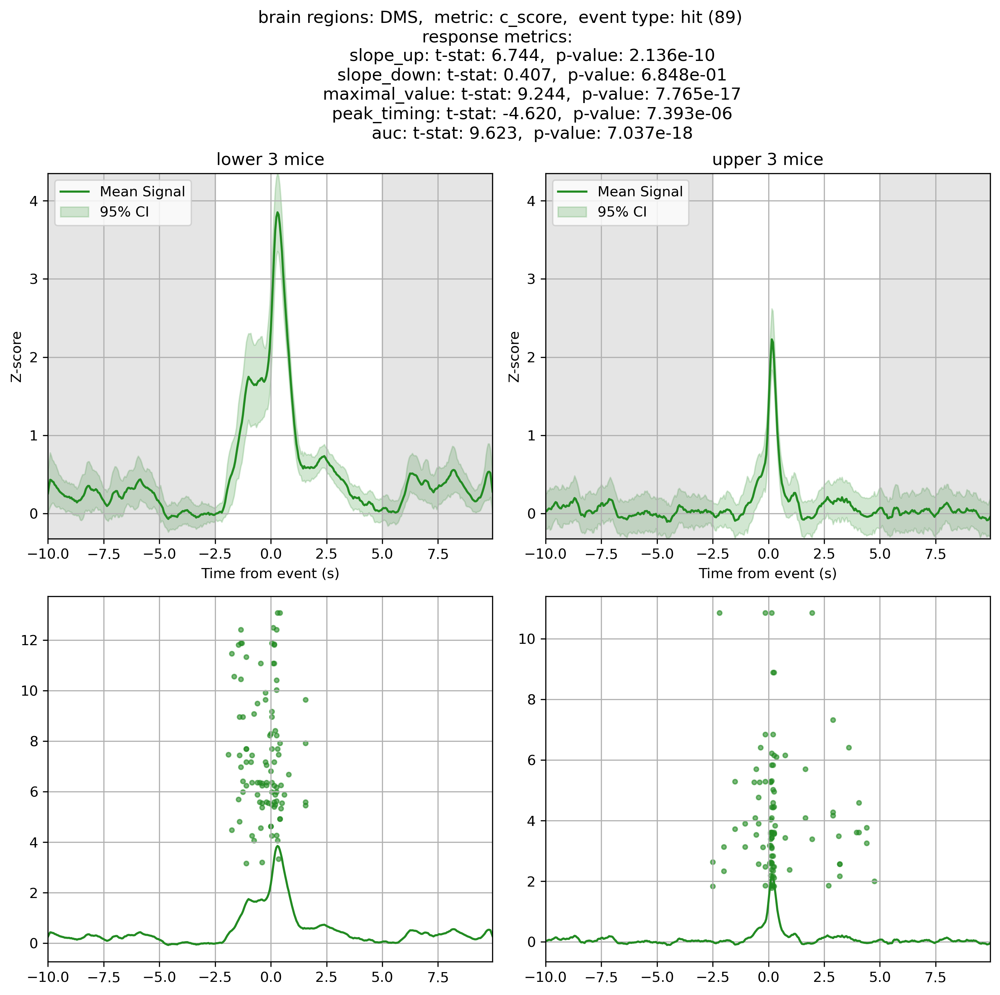

...

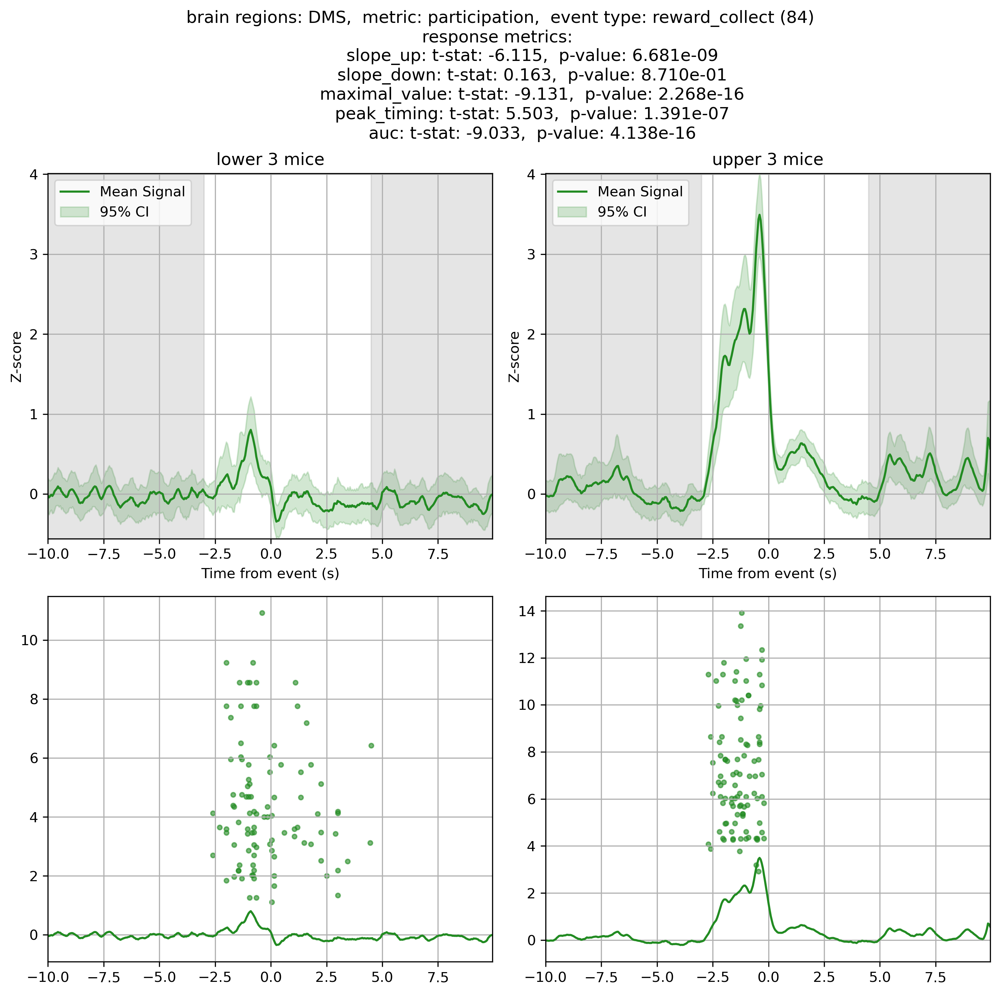

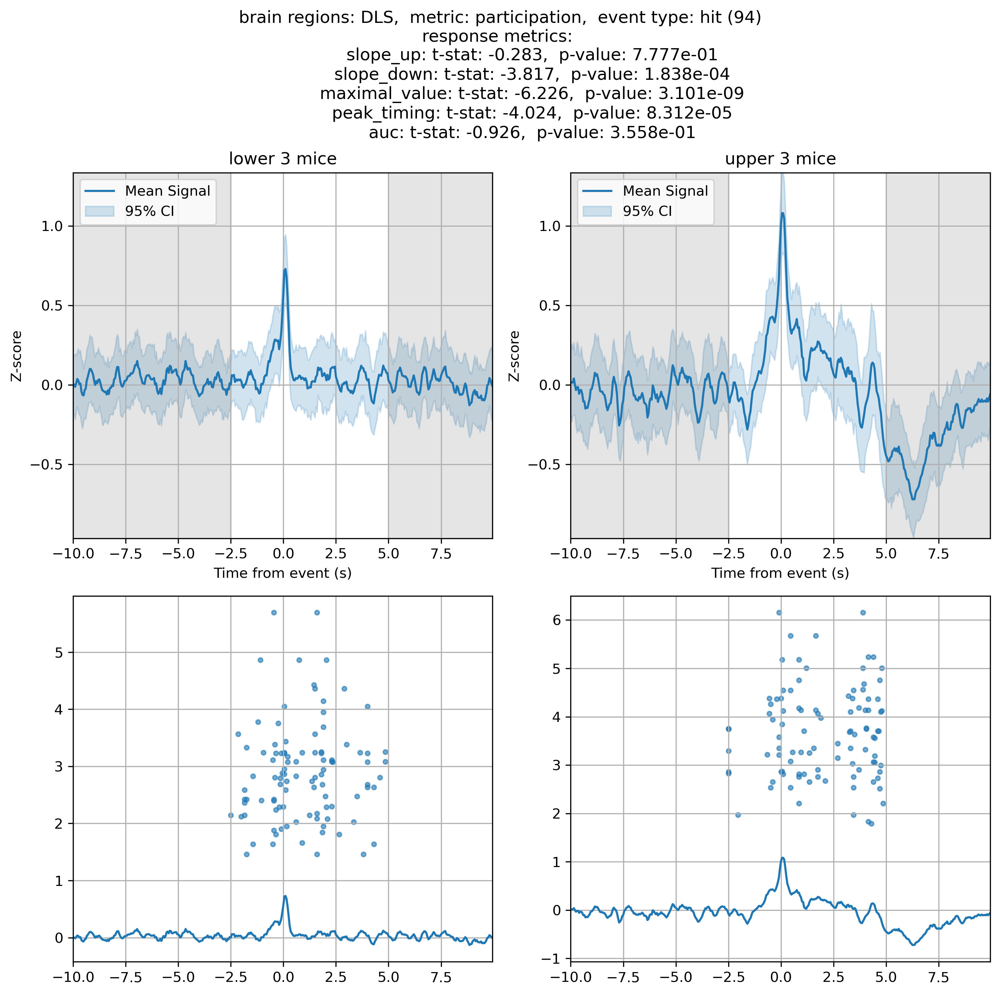

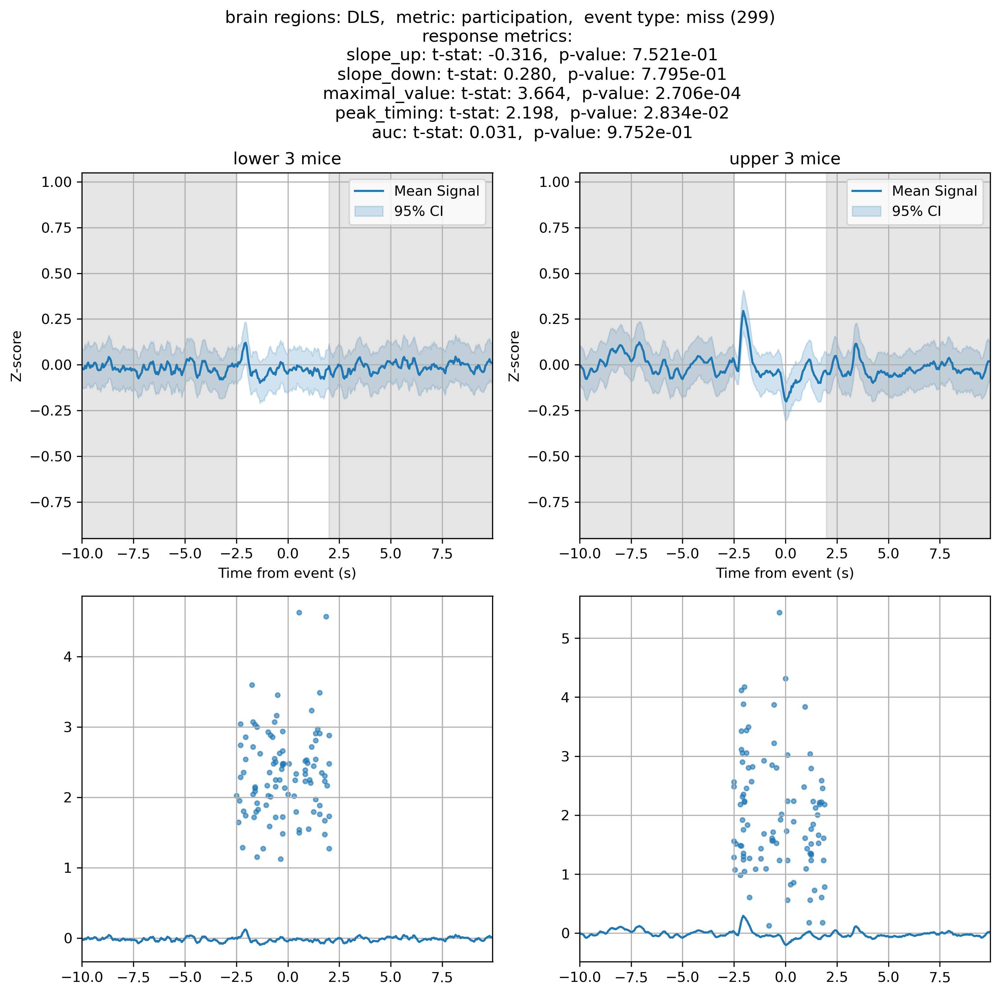

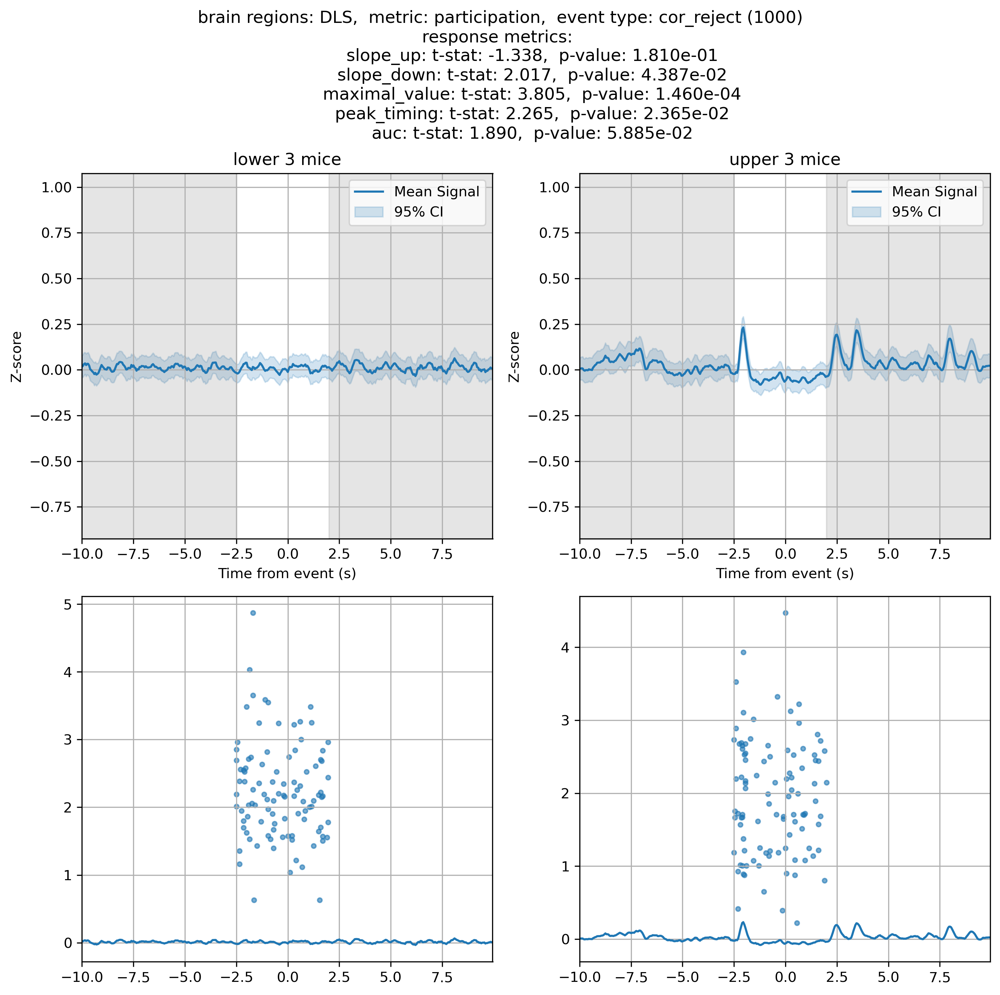

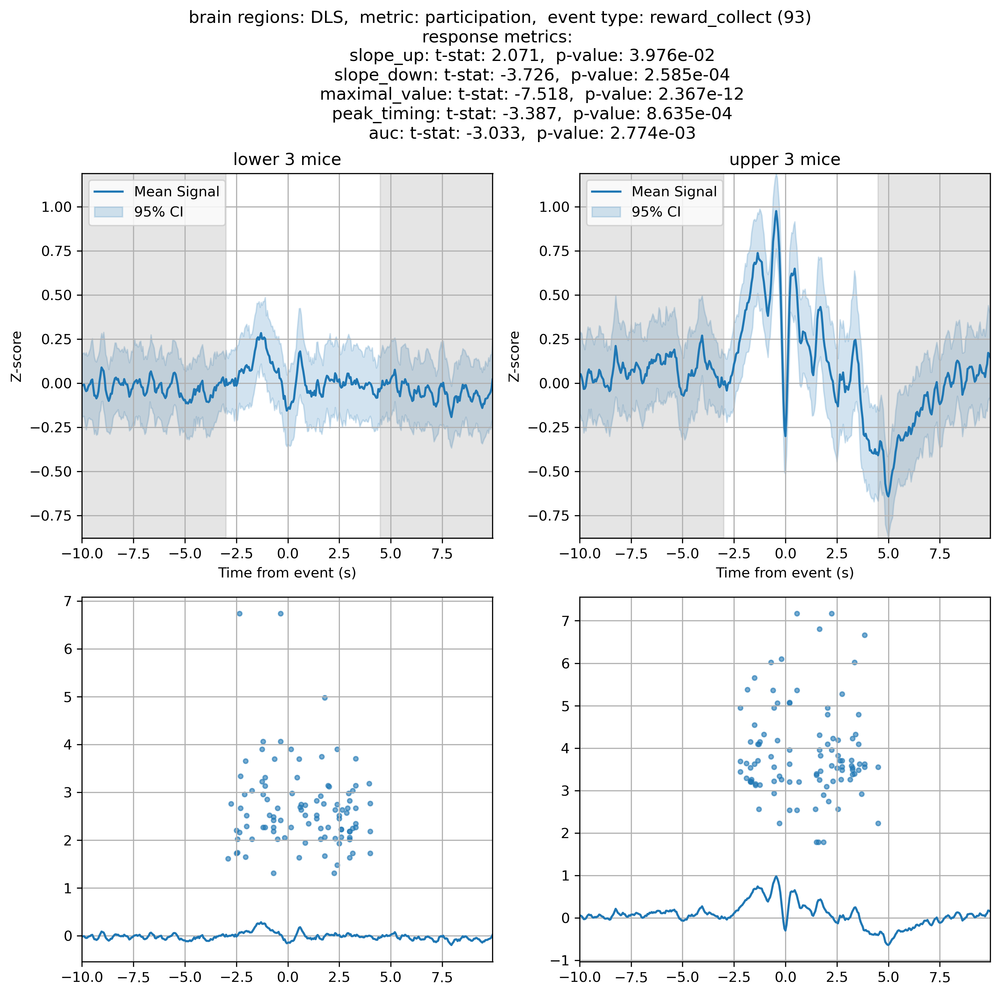

In [4]:
import itertools
import numpy as np
from scipy.stats import ttest_ind

brain_reg_to_color = {'VS': 'purple',
                      'DMS': 'forestgreen',
                      'DLS': 'C0'}

# Assuming config.all_metrics, config.all_brain_regions, and config.all_events are all iterable
for performance_metric, brain_region, event in itertools.product(all_metrics, all_brain_regions, all_event_types):
    low_sessions, high_sessions = \
        mouse_analyser.sample_high_and_low_sessions(performance_metric, brain_region, event)
    n = 1000
    low_signals, low_resp_metrics, resp_metric_names = sample_signals_and_metrics(low_sessions, event, brain_region)
    high_signals, high_resp_metrics, _ = sample_signals_and_metrics(high_sessions, event, brain_region)

    n = min(n, low_signals.shape[0], high_signals.shape[0])
    sample_idxs = np.random.choice(n, size=n, replace=False)

    low_signals = low_signals[sample_idxs]
    low_resp_metrics = low_resp_metrics[sample_idxs]

    high_signals = high_signals[sample_idxs]
    high_resp_metrics = high_resp_metrics[sample_idxs]

    sb = attr_interval_dict[event]

    scatters = [np.zeros((2, 100)), np.zeros((2, 100))]
    resp_metric_infos = []
    is_significant_p_vals = []

    for col_idx, resp_metric_name in resp_metric_names.items():
        low_resp_metric = low_resp_metrics[:, col_idx]
        high_resp_metric = high_resp_metrics[:, col_idx]

        if resp_metric_name == 'peak_timing':
            scatters[0][0] = np.random.choice(low_resp_metric + attr_interval_dict[event][0], 100, replace=True)
            scatters[1][0] = np.random.choice(high_resp_metric + attr_interval_dict[event][0], 100, replace=True)
        elif resp_metric_name == 'maximal_value':
            scatters[0][1] = np.random.choice(low_resp_metric, 100, replace=True)
            scatters[1][1] = np.random.choice(high_resp_metric, 100, replace=True)

        t_stat, p_value = ttest_ind(low_resp_metric, high_resp_metric, nan_policy='omit')
        resp_metric_infos.append(f"            {resp_metric_name}: t-stat: {t_stat:.3f},  p-value: {p_value:.3e}")
        is_significant_p_vals.append(p_value <= 1/3000)
        # if p_value > 1/3000:
        #     continue
    if not any(is_significant_p_vals):
        continue

    suptitle = f"brain regions: {brain_region},  metric: {performance_metric},  event type: {event} ({n})\nresponse metrics: "
    for resp_metric_info in resp_metric_infos:
        suptitle += f"\n{resp_metric_info}"

    low_subtitle = f"lower 3 mice"
    high_subtitle = f"upper 3 mice"

    color = brain_reg_to_color[brain_region]
    plot_signals([low_signals, high_signals], [low_subtitle, high_subtitle], suptitle, color, 
                    5, sb, scatters, fname=None)